## Use this section to evaluate model

In [ ]:
import json
from pycocotools.coco import COCO
from pycocotools.cocoeval import COCOeval

def calculate_map_recall(ground_truth_json, predictions_json):
    # Load ground truth and predictions
    coco_gt = COCO(ground_truth_json)
    coco_dt = coco_gt.loadRes(predictions_json)
    
    # Initialize COCOeval object
    coco_eval = COCOeval(coco_gt, coco_dt, 'bbox')
    
    # Run evaluation
    coco_eval.evaluate()
    coco_eval.accumulate()
    coco_eval.summarize()

    # Extract MAP and Recall
    map_score = coco_eval.stats[1]  # AP IoU=0.50:0.95 area=all maxDets=100
    recall_score = coco_eval.stats[8]  # AR IoU=0.50:0.95 area=all maxDets=100
    
    return map_score, recall_score

# Example usage
ground_truth_json = 'ground_truth/annotations_2560x1440.json'
predictions_json = 'predictions/filtered_predictions_1440p.json'

map_score, recall_score = calculate_map_recall(ground_truth_json, predictions_json)
print(f"Mean Average Precision (MAP): {map_score}")
print(f"Recall: {recall_score}")


In [ ]:
map_score

Number of annotations: 158650


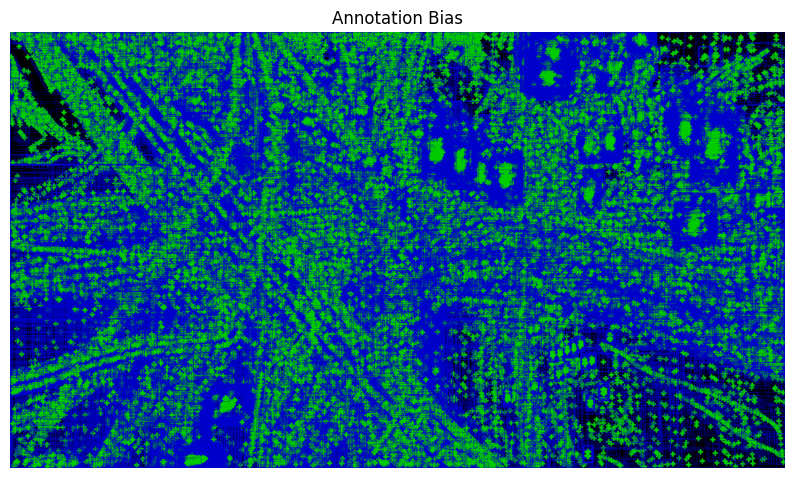

Number of annotations: 1773


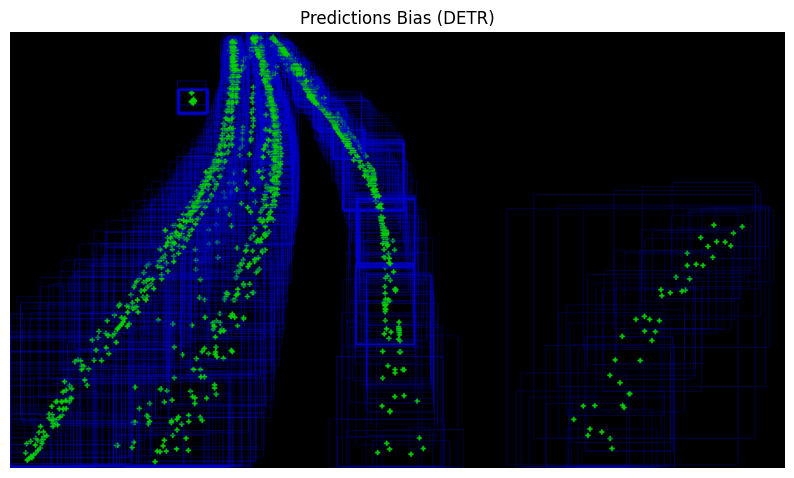

In [3]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
import json

def plot_annotation_bias(coco_json_file, alpha=0.8, title="Annotation Bias", color=(0, 255, 0), color_box=(0, 0, 255)):
    """
    Function which plots all the bounding boxes on an image to visualize the annotation bias.

    Args:
        coco_json_file (str): Path to the COCO JSON file containing the annotations.
        alpha (float): The transparency level of the bounding boxes.
        title (str): The title of the plot.
    """
    # Load the JSON file
    with open(coco_json_file) as f:
        data = json.load(f)

    # Get the image info and size from the JSON file
    image_info = data['images'][0]
    image_size = (image_info['height'], image_info['width'], 3)

    # Create a black image of the same size as the original image
    image = np.zeros(image_size, dtype=np.uint8)

    # Create a separate image for all bounding boxes
    bbox_image = np.zeros(image_size, dtype=np.uint8)

    # Get the annotations for the image
    anns = [ann for ann in data['annotations']]

    # Print the number of annotations
    print(f"Number of annotations: {len(anns)}")
    
    for ann in anns:
        bbox = ann['bbox']
        x, y, w, h = int(bbox[0]), int(bbox[1]), int(bbox[2]), int(bbox[3])

        # Draw the bounding box on the bounding box image
        cv2.rectangle(bbox_image, (x, y), (x + w, y + h), color_box, 1, cv2.LINE_AA)
        
        # Draw a marker at the center of the bounding box on the bounding box image
        center_x, center_y = x + w // 2, y + h // 2
        cv2.drawMarker(bbox_image, (center_x, center_y), color, cv2.MARKER_CROSS, markerSize=20, thickness=7, line_type=cv2.LINE_AA)

    # Overlay the bounding box image onto the original image with the specified alpha level
    image = cv2.addWeighted(image, 1-alpha, bbox_image, alpha, 0)

    # Display the image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title(title)
    plt.axis('off')
    plt.show()

# Example usage
ground_truth_json = 'ground_truth/annotations_3840x2160.json' 
predictions_json = 'predictions/DETR/predictions_2160p.json'
plot_annotation_bias(ground_truth_json)
plot_annotation_bias(predictions_json, title="Predictions Bias (DETR)")

Number of annotations for video1: 21964
Number of annotations for video2: 26155
Number of annotations for video3: 20050
Number of annotations for video4: 4617
Number of annotations for video5: 85864


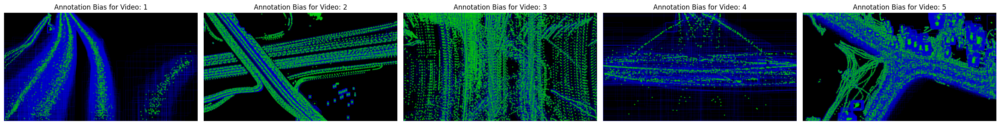

In [7]:
import matplotlib.pyplot as plt
import cv2
import numpy as np
import json
import os

def plot_annotation_bias(coco_json_file, alpha=0.8, color=(0, 255, 0), color_box=(0, 0, 255)):
    """
    Function which plots all the bounding boxes on multiple images to visualize the annotation bias.

    Args:
        coco_json_file (str): Path to the COCO JSON file containing the annotations.
        alpha (float): The transparency level of the bounding boxes.
    """
    # Load the JSON file
    with open(coco_json_file) as f:
        data = json.load(f)

    # Group annotations by video name
    anns_by_video = {}
    for ann in data['annotations']:
        image_id = ann['image_id']
        image_info = next(image for image in data['images'] if image['id'] == image_id)
        video_name = os.path.splitext(image_info['file_name'])[0].split('_')[0]
        if video_name not in anns_by_video:
            anns_by_video[video_name] = []
        anns_by_video[video_name].append(ann)

    # Sort the videos by name
    sorted_videos = sorted(anns_by_video.items(), key=lambda x: x[0])

    # Create a figure with 1 row and 5 columns
    fig, axs = plt.subplots(1, 5, figsize=(25, 5))

    # Plot biases for each video
    for i, (video_name, anns) in enumerate(sorted_videos):
        # Get the image info and size from the first annotation
        image_info = next(image for image in data['images'] if image['id'] == anns[0]['image_id'])
        image_size = (image_info['height'], image_info['width'], 3)

        # Create a black image of the same size as the original image
        image = np.zeros(image_size, dtype=np.uint8)

        # Create a separate image for all bounding boxes
        bbox_image = np.zeros(image_size, dtype=np.uint8)

        # Print the number of annotations
        print(f"Number of annotations for {video_name}: {len(anns)}")
        
        for ann in anns:
            bbox = ann['bbox']
            x, y, w, h = int(bbox[0]), int(bbox[1]), int(bbox[2]), int(bbox[3])

            # Draw the bounding box on the bounding box image
            cv2.rectangle(bbox_image, (x, y), (x + w, y + h), color_box, 1, cv2.LINE_AA)
            
            # Draw a marker at the center of the bounding box on the bounding box image
            center_x, center_y = x + w // 2, y + h // 2
            cv2.drawMarker(bbox_image, (center_x, center_y), color, cv2.MARKER_CROSS, markerSize=20, thickness=7, line_type=cv2.LINE_AA)

        # Overlay the bounding box image onto the original image with the specified alpha level
        image = cv2.addWeighted(image, 1-alpha, bbox_image, alpha, 0)

        # Display the image
        axs[i].imshow(image)
        axs[i].set_title(f"Annotation Bias for {video_name.capitalize()[:-1]}: {video_name[-1]}")
        axs[i].axis('off')

    plt.tight_layout()
    plt.show()

# Example usage
ground_truth_json = 'ground_truth/annotations_3840x2160.json' 
plot_annotation_bias(ground_truth_json)

Number of annotations: 158650


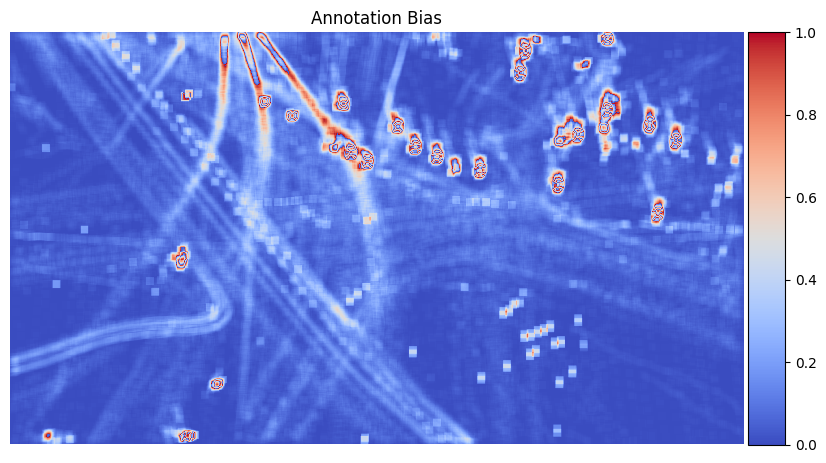

Number of annotations: 158650


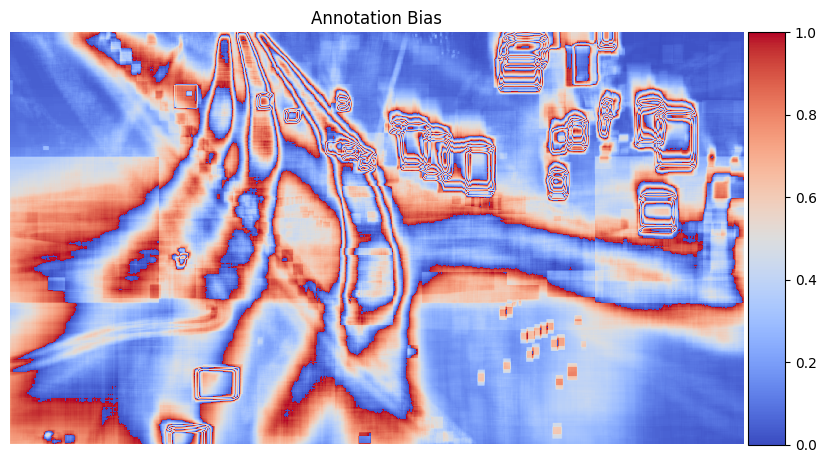

Number of annotations: 1773


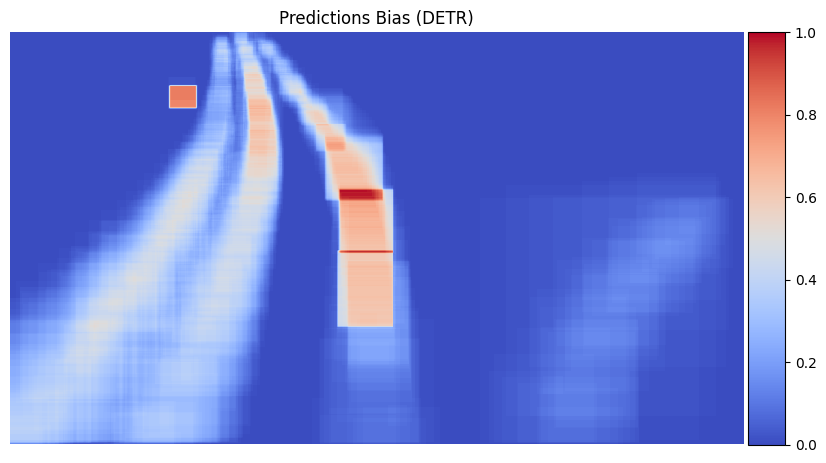

In [18]:
import matplotlib.pyplot as plt
import numpy as np
import json
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_annotation_bias(coco_json_file, mode='box', title="Annotation Bias"):
    """
    Function which plots all the bounding boxes or the center of the bounding boxes on an image to visualize the annotation bias.

    Args:
        coco_json_file (str): Path to the COCO JSON file containing the annotations.
        mode (str): The mode of the plot. Can be either 'box' or 'marker'.
        title (str): The title of the plot.
    """
    # Load the JSON file
    with open(coco_json_file) as f:
        data = json.load(f)

    # Get the image info and size from the JSON file
    image_info = data['images'][0]
    image_size = (image_info['height'], image_info['width'])

    # Create a black image of the same size as the original image
    image = np.zeros(image_size, dtype=np.uint8)

    # Get the annotations for the image
    anns = [ann for ann in data['annotations']]

    # Print the number of annotations
    print(f"Number of annotations: {len(anns)}")
    
    for ann in anns:
        bbox = ann['bbox']
        x, y, w, h = int(bbox[0]), int(bbox[1]), int(bbox[2]), int(bbox[3])

        if mode == 'box':
            # Increase the pixel intensity in the bounding box area using NumPy's advanced indexing
            image[y:y+h, x:x+w] += 1
        elif mode == 'marker':
            # Mark the center of the bounding box
            cx, cy = x + w // 2, y + h // 2
            marker_size = 20  # size of the marker, change as needed

            # Increase the pixel intensity in a small region around the center
            image[max(0, cy-marker_size):min(image.shape[0], cy+marker_size+1), 
                max(0, cx-marker_size):min(image.shape[1], cx+marker_size+1)] += 1

    # Normalize the image to the range [0, 1]
    image = image / np.max(image)

    # Display the image as a heatmap
    fig, ax = plt.subplots(figsize=(10, 10))
    im = ax.imshow(image, cmap='coolwarm', interpolation='nearest')
    ax.set_title(title)
    ax.axis('off')

    # Create a colorbar that matches the image size
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    fig.colorbar(im, cax=cax)

    plt.show()

# Example usage
ground_truth_json = 'ground_truth/annotations_3840x2160.json' 
predictions_json = 'predictions/DETR/predictions_2160p.json'
plot_annotation_bias(ground_truth_json, mode='marker')
plot_annotation_bias(ground_truth_json, mode='box')
plot_annotation_bias(predictions_json, mode='box', title="Predictions Bias (DETR)")

loading annotations into memory...
Done (t=0.65s)
creating index...
index created!


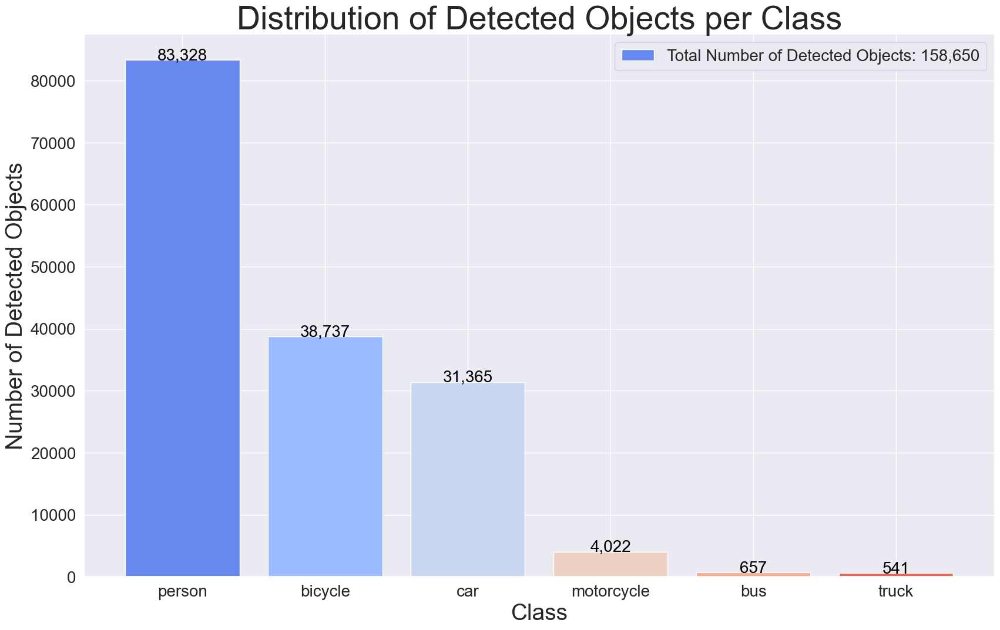

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


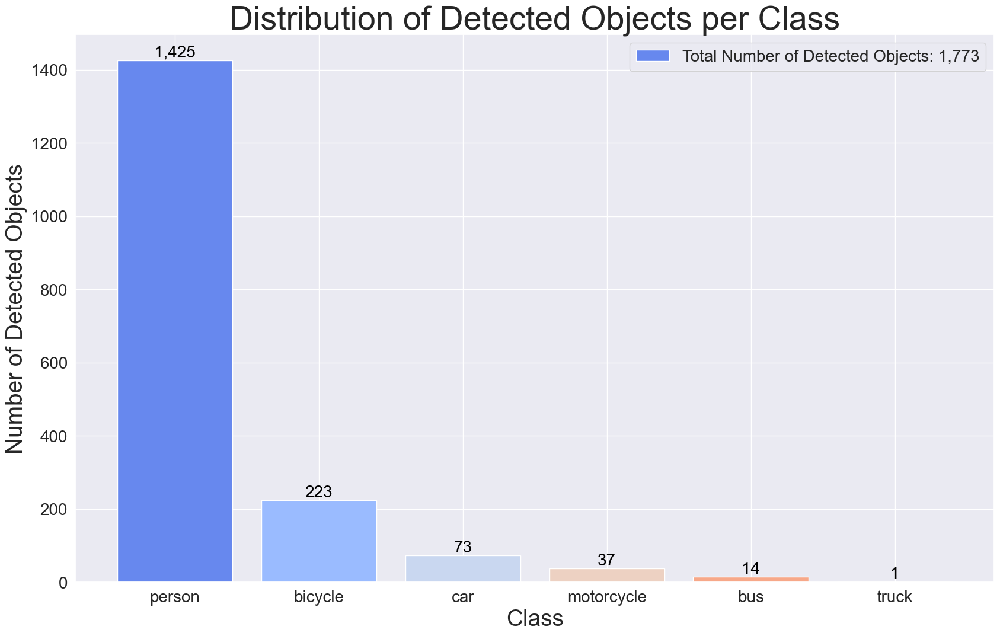

In [16]:
import matplotlib.pyplot as plt
import seaborn as sns
from collections import defaultdict
from pycocotools.coco import COCO


def plot_distribution_for_detected_objects(coco_json_file):
    """
    Function which plots a distribution for the number of detected objects per image, giving a bar for each class.

    Args:
        coco_json_file (str): Path to the COCO JSON file containing the annotations.
    """
    # Load COCO annotations
    coco = COCO(coco_json_file)

    # Initialise dictionary to store the number of detected objects per class
    detected_objects_per_class = defaultdict(int)

    # Iterate over each annotation
    for ann in coco.dataset['annotations']:
        category_id = ann['category_id']
        detected_objects_per_class[category_id] += 1

    # Get category names
    categories = coco.loadCats(coco.getCatIds())
    category_names = [category['name'] for category in categories]

    # Plot distribution
    # Set seaborn style
    sns.set_theme()

    # Create a color palette
    palette = sns.color_palette("coolwarm", len(detected_objects_per_class))

    # Sort the values to align with the color palette
    sorted_values = sorted(detected_objects_per_class.values(), reverse=True)

    # Create a figure and a bar plot
    plt.figure(figsize=(20, 12))
    bars = plt.bar(category_names, sorted_values, color=palette)

    # Set labels and title
    plt.xlabel('Class', fontsize=28)
    plt.ylabel('Number of Detected Objects', fontsize=28)
    plt.title('Distribution of Detected Objects per Class', fontsize=40)

    # Set xticks and tick parameters
    plt.xticks(fontsize=20)
    plt.tick_params(axis='both', which='major', labelsize=20)

    # Plotting the number of detected Objects above the bars
    for i, v in enumerate(sorted_values):
        plt.text(i, v + 10, format(v, ','), color='black', ha='center', fontsize=20)

    # Adding a total number of detected objects to the plot on the legend
    total_detected_objects = sum(sorted_values)
    plt.legend([f'Total Number of Detected Objects: {format(total_detected_objects, ",")}'], fontsize=20)

    # Show the plot
    plt.show()

# Example usage
ground_truth_json = 'ground_truth/annotations_3840x2160.json'
predictions_json = 'predictions/DETR/predictions_2160p.json'

plot_distribution_for_detected_objects(ground_truth_json)
plot_distribution_for_detected_objects(predictions_json)


In [ ]:
import json
from pycocotools.coco import COCO

def compare_image_ids(ground_truth_json, predictions_json):
    # Load ground truth
    coco_gt = COCO(ground_truth_json)
    
    # Load predictions
    with open(predictions_json, 'r') as f:
        predictions_data = json.load(f)
    
    gt_image_ids = set(coco_gt.getImgIds())
    dt_image_ids = set(pred['image_id'] for pred in predictions_data)
    
    missing_in_predictions = gt_image_ids - dt_image_ids
    extra_in_predictions = dt_image_ids - gt_image_ids
    
    if missing_in_predictions:
        print(f"Missing Image IDs in Predictions: {sorted(missing_in_predictions)}")
    else:
        print("No missing Image IDs in Predictions.")
    
    if extra_in_predictions:
        print(f"Extra Image IDs in Predictions: {sorted(extra_in_predictions)}")
    else:
        print("No extra Image IDs in Predictions.")

# Example usage
ground_truth_json = 'ground_truth/annotations_2560x1440.json'
predictions_json = 'predictions/predictions_1440p.json'

compare_image_ids(ground_truth_json, predictions_json)


<h2>Use this section to check that the BBOX from the ground truth are correct</h2>

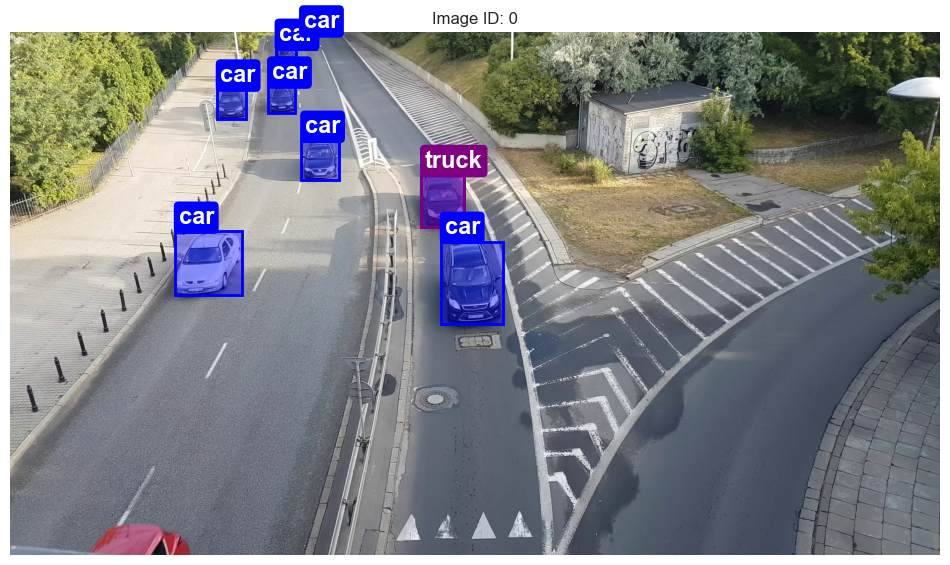

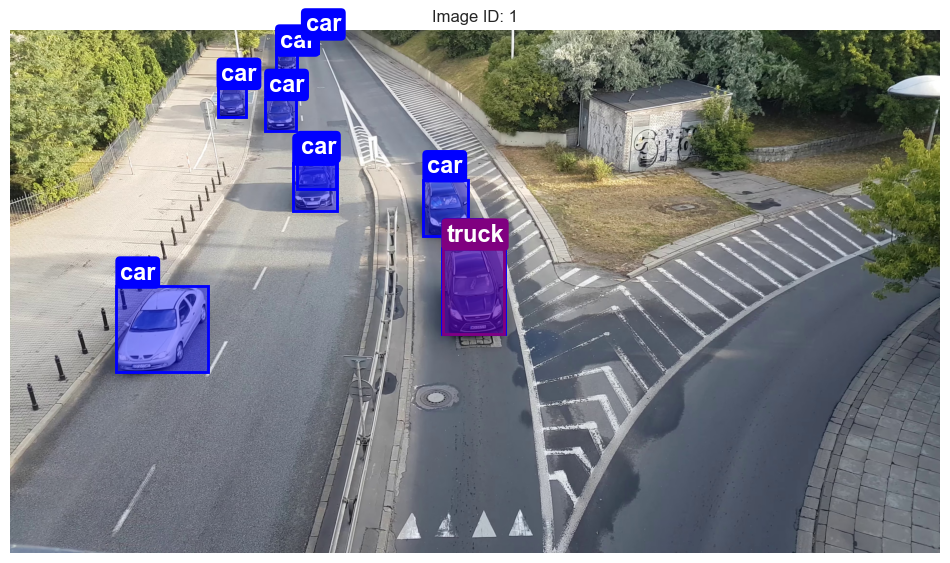

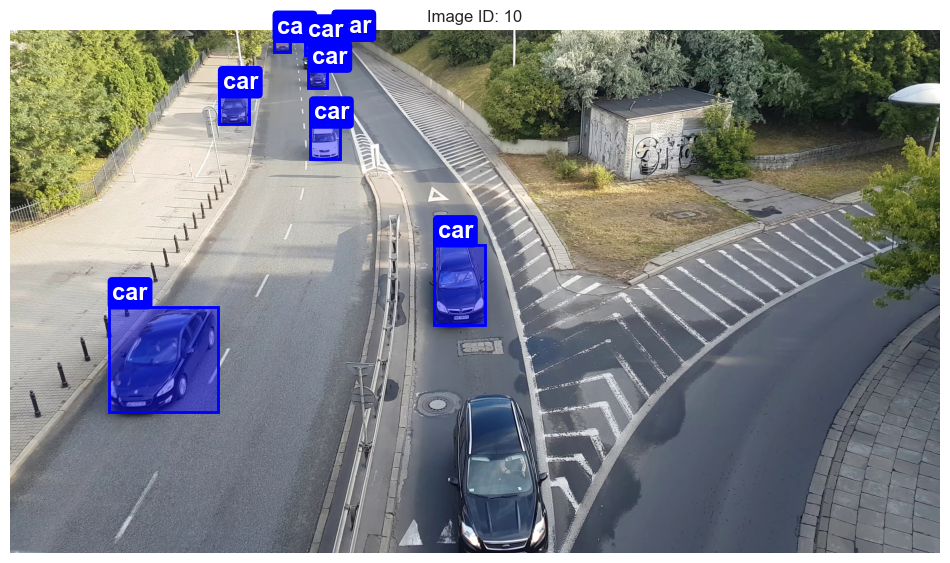

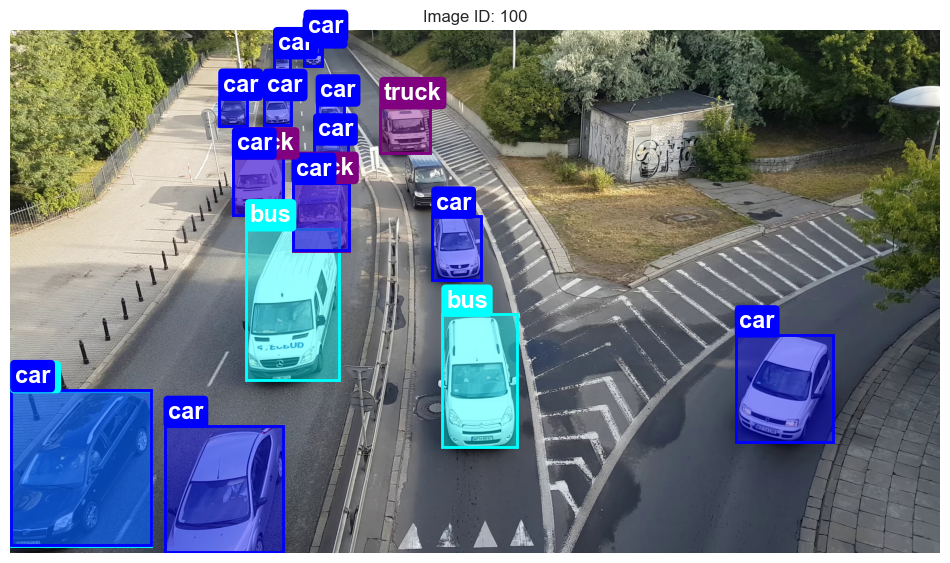

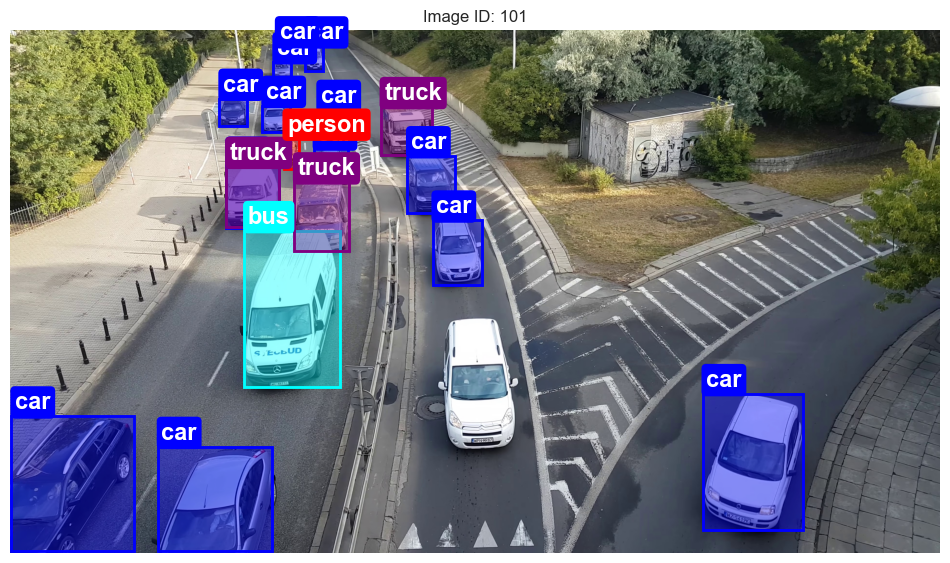

...

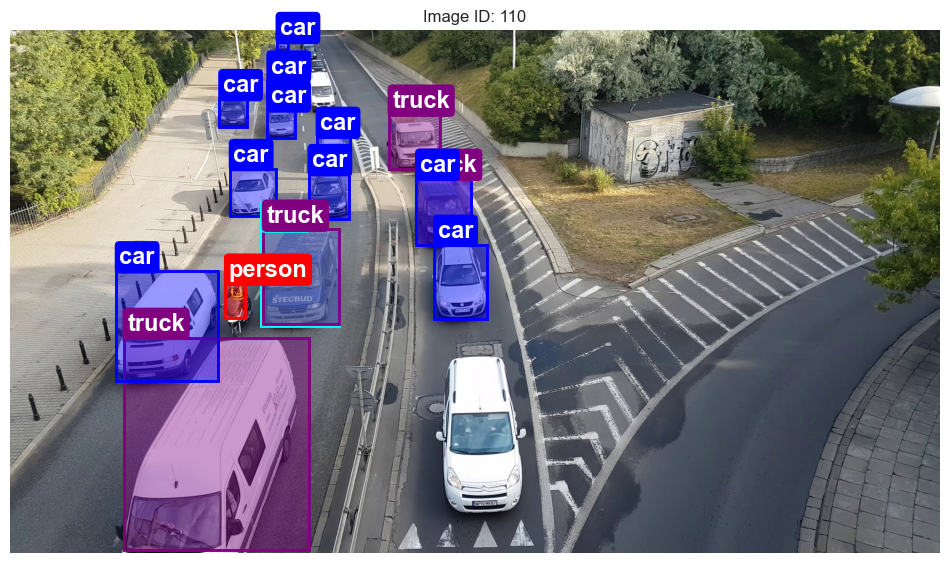

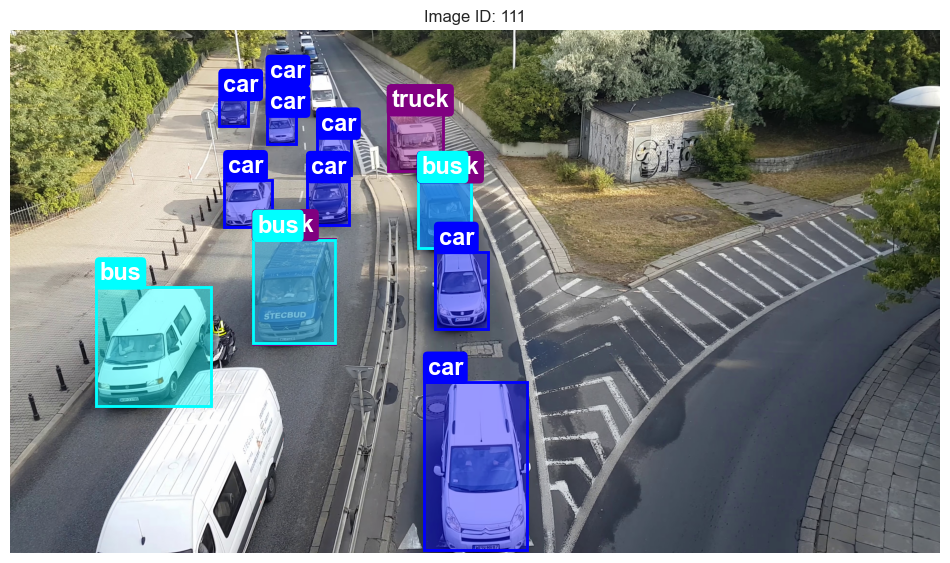

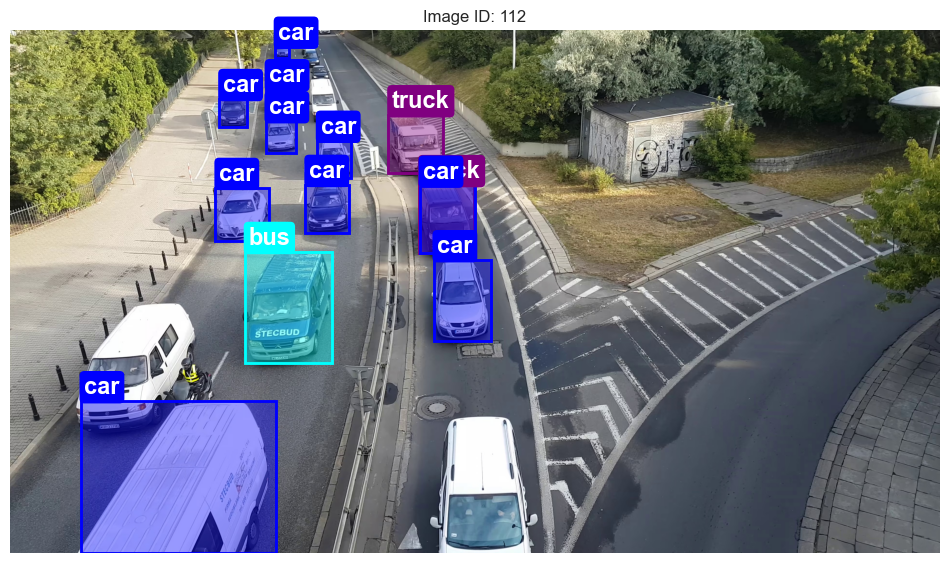

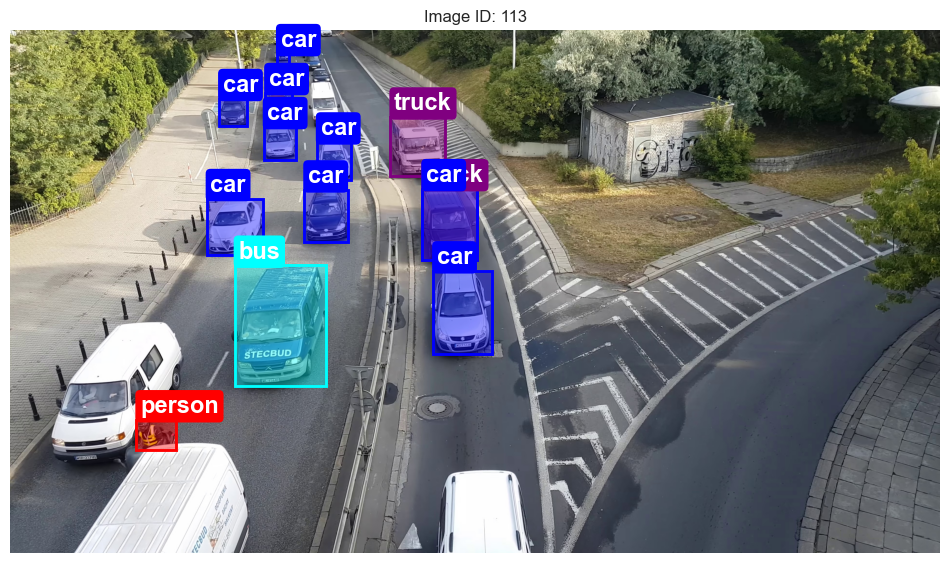

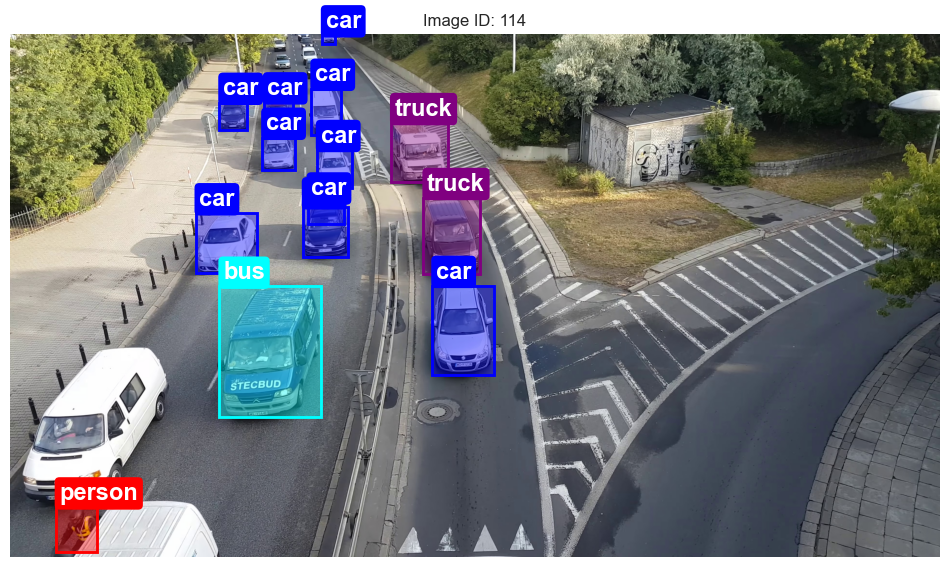

KeyboardInterrupt: 

In [40]:
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

# Defining constant label colors, which will be used to draw bounding boxes and are in BGR format
LABEL_COLORS = {
    'person': (255/255, 0/255, 0/255),  # Blue
    'bicycle': (255/255, 220/255, 0/255),  # Yellow
    'car': (0/255, 0/255, 255/255),  # Red
    'motorcycle': (255/255, 0/255, 255/255),  # Magenta
    'bus': (0/255, 255/255, 255/255),  # Cyan
    'truck': (128/255, 0/255, 128/255),  # Purple
}

def display_images_with_bboxes(ground_truth_json, images_folder, alpha=0.4):
    # Load ground truth JSON
    with open(ground_truth_json, 'r') as f:
        data = json.load(f)
    
    images_data = {img['id']: img for img in data['images']}
    annotations_data = data['annotations']
    categories = {cat['id']: cat['name'] for cat in data['categories']}
    colors = LABEL_COLORS
    
    # Group annotations by image_id
    annotations_by_image = {}
    for annotation in annotations_data:
        image_id = annotation['image_id']
        if image_id not in annotations_by_image:
            annotations_by_image[image_id] = []
        annotations_by_image[image_id].append(annotation)
    
    for image_id, annotations in annotations_by_image.items():
        image_info = images_data[image_id]
        image_path = os.path.join(images_folder, image_info['file_name'])
        # Set the image path to find the jpg extesnion and remove everything after it
        # image_path = image_path.split('_jpg')[0] + '.jpg'
        
        # Open image
        image = Image.open(image_path)
        fig, ax = plt.subplots(1, figsize=(12, 8))
        ax.imshow(image)

        # Sort the annotations by area to draw larger boxes first
        annotations = sorted(annotations, key=lambda x: x['area'], reverse=True)
        
        # Draw bounding boxes and labels
        for annotation in annotations:
            bbox = annotation['bbox']
            category_id = annotation['category_id']
            label = categories[category_id]
            
            # Adding a filled rectangle on the bounding box ROI with alpha 0.4
            filled_rect = patches.Rectangle(
                (bbox[0], bbox[1]), bbox[2], bbox[3],
                linewidth=2, edgecolor=colors[categories[category_id]], facecolor=colors[categories[category_id]], alpha=alpha
            )

            # Adding the filled rectangle to the image
            ax.add_patch(filled_rect)

            # Adding an unfilled rectangle on the bounding box ROI with alpha 1
            unfilled_rect = patches.Rectangle(
                (bbox[0], bbox[1]), bbox[2], bbox[3],
                linewidth=2, edgecolor=colors[categories[category_id]], facecolor='none', alpha=1
            )

            # Adding the unfilled rectangle to the image
            ax.add_patch(unfilled_rect)

            # Adding a transparent rectangel with the full width of the image to display the label
            plt.text(bbox[0]+15, bbox[1]-30, label, 
            color='white', 
            fontsize=17, 
            weight='bold',
            bbox=dict(facecolor=colors[categories[category_id]], edgecolor='none', boxstyle='round,pad=0.2'))
        
        plt.title(f"Image ID: {image_id}")
        plt.axis('off')
        plt.show()


# Example usage
ground_truth_json = 'predictions/RetinaNet/predictions_2160p.json'#'ground_truth/annotations_3840x2160.json' #'_annotations.coco.json'
images_folder = 'frames/2160p'  # Replace with the path to the folder containing images
display_images_with_bboxes(ground_truth_json, images_folder)


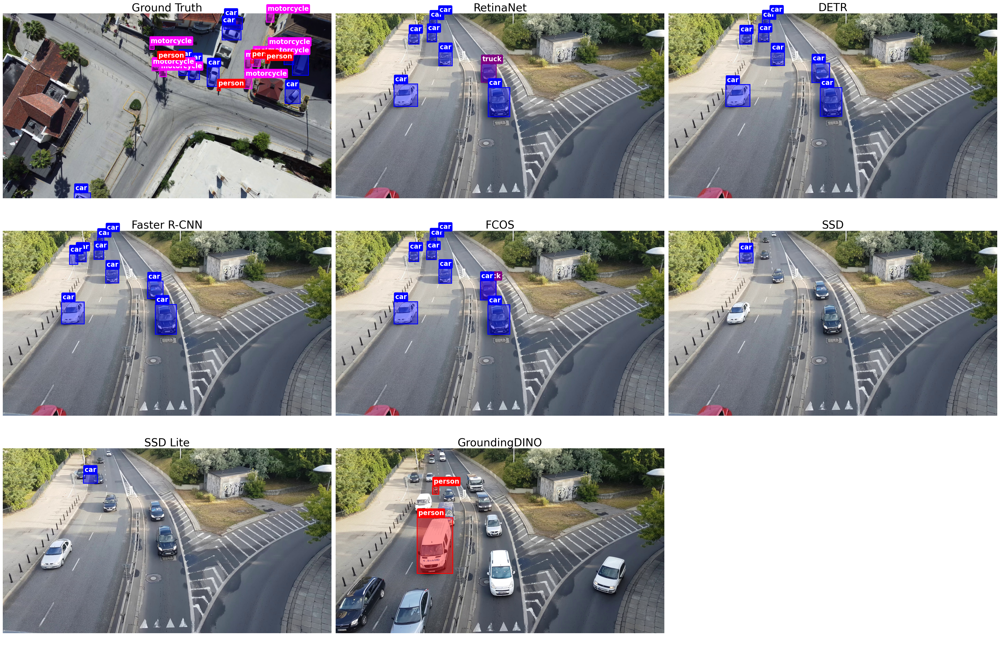

In [2]:
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os
import numpy as np

# Defining constant label colors, which will be used to draw bounding boxes and are in BGR format
LABEL_COLORS = {
    'person': (255/255, 0/255, 0/255),  # Blue
    'bicycle': (255/255, 220/255, 0/255),  # Yellow
    'car': (0/255, 0/255, 255/255),  # Red
    'motorcycle': (255/255, 0/255, 255/255),  # Magenta
    'bus': (0/255, 255/255, 255/255),  # Cyan
    'truck': (128/255, 0/255, 128/255),  # Purple
}

def display_images_with_bboxes_list(ground_truth_json_list, title_list, images_folder, alpha=0.4):
    # Create a subplot for each image
    num_cols = 3
    num_rows = np.ceil(len(ground_truth_json_list) / num_cols).astype(int)

    fig, axs = plt.subplots(num_rows, num_cols, figsize=(12 * num_cols, 8 * num_rows))
    
    # Flatten the array of Axes objects
    axs = axs.flatten()

    for ax, ground_truth_json, title in zip(axs, ground_truth_json_list, title_list):
        # Load ground truth JSON
        with open(ground_truth_json, 'r') as f:
            data = json.load(f)
        
        images_data = {img['id']: img for img in data['images']}
        annotations_data = data['annotations']
        categories = {cat['id']: cat['name'] for cat in data['categories']}
        colors = LABEL_COLORS
        
        # Group annotations by image_id
        annotations_by_image = {}
        for annotation in annotations_data:
            image_id = annotation['image_id']
            if image_id not in annotations_by_image:
                annotations_by_image[image_id] = []
            annotations_by_image[image_id].append(annotation)
        
        for image_id, annotations in annotations_by_image.items():
            image_info = images_data[image_id]
            image_path = os.path.join(images_folder, image_info['file_name'])
            
            # Open image
            image = Image.open(image_path)
            ax.imshow(image)

            # Sort the annotations by area to draw larger boxes first
            annotations = sorted(annotations, key=lambda x: x['area'], reverse=True)
            
            # Draw bounding boxes and labels
            for annotation in annotations:
                bbox = annotation['bbox']
                category_id = annotation['category_id']
                label = categories[category_id]
                
                # Adding a filled rectangle on the bounding box ROI with alpha 0.4
                filled_rect = patches.Rectangle(
                    (bbox[0], bbox[1]), bbox[2], bbox[3],
                    linewidth=2, edgecolor=colors[categories[category_id]], facecolor=colors[categories[category_id]], alpha=alpha
                )

                # Adding the filled rectangle to the image
                ax.add_patch(filled_rect)

                # Adding an unfilled rectangle on the bounding box ROI with alpha 1
                unfilled_rect = patches.Rectangle(
                    (bbox[0], bbox[1]), bbox[2], bbox[3],
                    linewidth=2, edgecolor=colors[categories[category_id]], facecolor='none', alpha=1
                )

                # Adding the unfilled rectangle to the image
                ax.add_patch(unfilled_rect)

                # Adding a transparent rectangel with the full width of the image to display the label
                ax.text(bbox[0]+15, bbox[1]-30, label, 
                color='white', 
                fontsize=17, 
                weight='bold',
                bbox=dict(facecolor=colors[categories[category_id]], edgecolor='none', boxstyle='round,pad=0.2'))
            
            ax.set_title(title, fontsize=28)
            ax.axis('off')

            # Only display the first image
            break

    # Setting the remaining axes off
    for ax in axs[len(ground_truth_json_list):]:
        ax.axis('off')
    
    plt.tight_layout()
    plt.show()


# Example usage
ground_truth_json_list =   ['ground_truth/annotations_3840x2160.json',
                            'predictions/RetinaNet/predictions_2160p.json', 'predictions/DETR/predictions_2160p.json',
                            'predictions/FasterRCNN/predictions_2160p.json', 'predictions/FCOS/predictions_2160p.json',
                            'predictions/SSD/predictions_2160p.json', 'predictions/SSDLite/predictions_2160p.json',
                            'predictions/GroundingDINO/predictions_2160p.json',]
title_list = ['Ground Truth', 'RetinaNet', 'DETR', 'Faster R-CNN', 'FCOS', 'SSD', 'SSD Lite', 'GroundingDINO']
images_folder = 'frames/2160p'  # Replace with the path to the folder containing images
display_images_with_bboxes_list(ground_truth_json_list, title_list, images_folder)


In [ ]:
import json
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image
import os

def display_images_with_bboxes(ground_truth_json, prediction_json, images_folder):
    # Load ground truth JSON
    with open(ground_truth_json, 'r') as f:
        gt_data = json.load(f)
    
    # Load prediction JSON
    with open(prediction_json, 'r') as f:
        pred_data = json.load(f)
    
    images_data = {img['id']: img for img in gt_data['images']}
    gt_annotations_data = gt_data['annotations']
    categories = {cat['id']: cat['name'] for cat in gt_data['categories']}
    
    # Group ground truth annotations by image_id
    gt_annotations_by_image = {}
    for annotation in gt_annotations_data:
        image_id = annotation['image_id']
        if image_id not in gt_annotations_by_image:
            gt_annotations_by_image[image_id] = []
        gt_annotations_by_image[image_id].append(annotation)
    
    # Group predictions by image_id
    pred_annotations_by_image = {}
    for annotation in pred_data:
        image_id = annotation['image_id']
        if image_id not in pred_annotations_by_image:
            pred_annotations_by_image[image_id] = []
        pred_annotations_by_image[image_id].append(annotation)
    
    for image_id, gt_annotations in gt_annotations_by_image.items():
        image_info = images_data[image_id]
        image_path = os.path.join(images_folder, image_info['file_name'])
        
        # Open image
        image = Image.open(image_path)
        fig, ax = plt.subplots(1, figsize=(12, 8))
        ax.imshow(image)
        
        # Draw ground truth bounding boxes in red
        for annotation in gt_annotations:
            bbox = annotation['bbox']
            category_id = annotation['category_id']
            label = categories[category_id]
            
            rect = patches.Rectangle(
                (bbox[0], bbox[1]), bbox[2], bbox[3],
                linewidth=2, edgecolor='r', facecolor='none'
            )
            ax.add_patch(rect)
            plt.text(bbox[0], bbox[1] - 10, label, color='red', fontsize=12, weight='bold')
        
        # Draw prediction bounding boxes in green
        if image_id in pred_annotations_by_image:
            pred_annotations = pred_annotations_by_image[image_id]
            for annotation in pred_annotations:
                bbox = annotation['bbox']
                category_id = annotation['category_id']
                label = categories[category_id] if category_id in categories else "unknown"
                
                rect = patches.Rectangle(
                    (bbox[0], bbox[1]), bbox[2], bbox[3],
                    linewidth=2, edgecolor='g', facecolor='none'
                )
                ax.add_patch(rect)
                plt.text(bbox[0], bbox[1] - 10, label, color='green', fontsize=12, weight='bold')
        
        plt.title(f"Image ID: {image_id}")
        plt.axis('off')
        plt.show()


# Example usage
ground_truth_json = 'ground_truth/annotations_2560x1440.json'
prediction_json = 'updated_predictions/predictions_1440p.json'
images_folder = 'frames/1440p'  # Replace with the path to the folder containing images
display_images_with_bboxes(ground_truth_json, prediction_json, images_folder)


<h2>Resize annotation for different resolutions</h2>

In [ ]:
import json
import os

def resize_annotations(original_bbox, original_size, new_size):
    x_scale = new_size[0] / original_size[0]
    y_scale = new_size[1] / original_size[1]
    x, y, width, height = original_bbox
    new_bbox = [x * x_scale, y * y_scale, width * x_scale, height * y_scale]
    return new_bbox

def resize_annotations_only(ground_truth_json, output_folder, target_sizes):
    with open(ground_truth_json, 'r') as f:
        data = json.load(f)
    
    original_width, original_height = 3840, 2160  # Assuming 4K resolution
    
    for target_size in target_sizes:
        width, height = target_size
        new_data = data.copy()
        new_data['images'] = []
        new_data['annotations'] = []
        
        for img in data['images']:
            new_img = img.copy()
            new_img['width'] = width
            new_img['height'] = height
            new_data['images'].append(new_img)
            
            for ann in data['annotations']:
                if ann['image_id'] == img['id']:
                    new_ann = ann.copy()
                    new_ann['bbox'] = resize_annotations(ann['bbox'], (original_width, original_height), (width, height))
                    new_data['annotations'].append(new_ann)
        
        resized_annotation_path = os.path.join(output_folder, f"annotations_{width}x{height}.json")
        os.makedirs(output_folder, exist_ok=True)
        with open(resized_annotation_path, 'w') as f:
            json.dump(new_data, f, indent=4)
        
        print(f"Resized annotations saved for {width}x{height}")

# Example usage
ground_truth_json = 'ground_truth/ground_truth.json'
output_folder = 'ground_truth/'  # Replace with the path to the folder for saving resized annotations
target_sizes = [(3840, 2160), (2560, 1440), (1920, 1080), (1280, 720), (854, 480), (640, 360)]

resize_annotations_only(ground_truth_json, output_folder, target_sizes)


In [ ]:
import json
import csv

# Function to extract the required part of the file name and adjust the format
def extract_base_name(file_name):
    base_name = file_name.split('.rf.')[0]
    return base_name.replace('_jpg', '.jpg')

# Load the original dataset
with open('_annotations.coco.json', 'r') as file:
    data = json.load(file)

# Create a mapping from image ID to the adjusted base name
image_id_to_name = {
    image['id']: extract_base_name(image['file_name']) for image in data['images']
}

# Extract license plate annotations
license_plate_annotations = [
    {
        'ImageName': image_id_to_name[annotation['image_id']],
        'x': annotation['bbox'][0],
        'y': annotation['bbox'][1],
        'width': annotation['bbox'][2],
        'height': annotation['bbox'][3],
        'label': ''
    }
    for annotation in data['annotations'] if annotation['category_id'] == 3
]

# Save to CSV
with open('license_plate_annotations.csv', 'w', newline='') as csvfile:
    fieldnames = ['ImageName', 'x', 'y', 'width', 'height', 'label']
    writer = csv.DictWriter(csvfile, fieldnames=fieldnames)

    writer.writeheader()
    for item in license_plate_annotations:
        writer.writerow(item)

print("CSV file created successfully!")